<a href="https://colab.research.google.com/github/madhurima99/Classify-Music-Clips/blob/main/Audio_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import necessary libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
import IPython
import librosa
import librosa.display
import seaborn as sns
import warnings

In [ ]:
warnings.filterwarnings("ignore")

# Audio Data Exploration

In [ ]:
genres = ['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']

In [ ]:
IPython.display.display(IPython.display.Markdown("### Sample audio clips from every genre: -"))
for gen in genres:
    path = f'./genres/{gen}/{gen}.00000.wav'
    IPython.display.display(IPython.display.Markdown("#### "+gen))
    IPython.display.display(IPython.display.Audio(path))
    

### Sample audio clips from every genre: -

#### blues

#### classical

#### country

#### disco

#### hiphop

#### jazz

#### metal

#### pop

#### reggae

#### rock

Text(0.5, 0.98, 'WAVE PLOT')

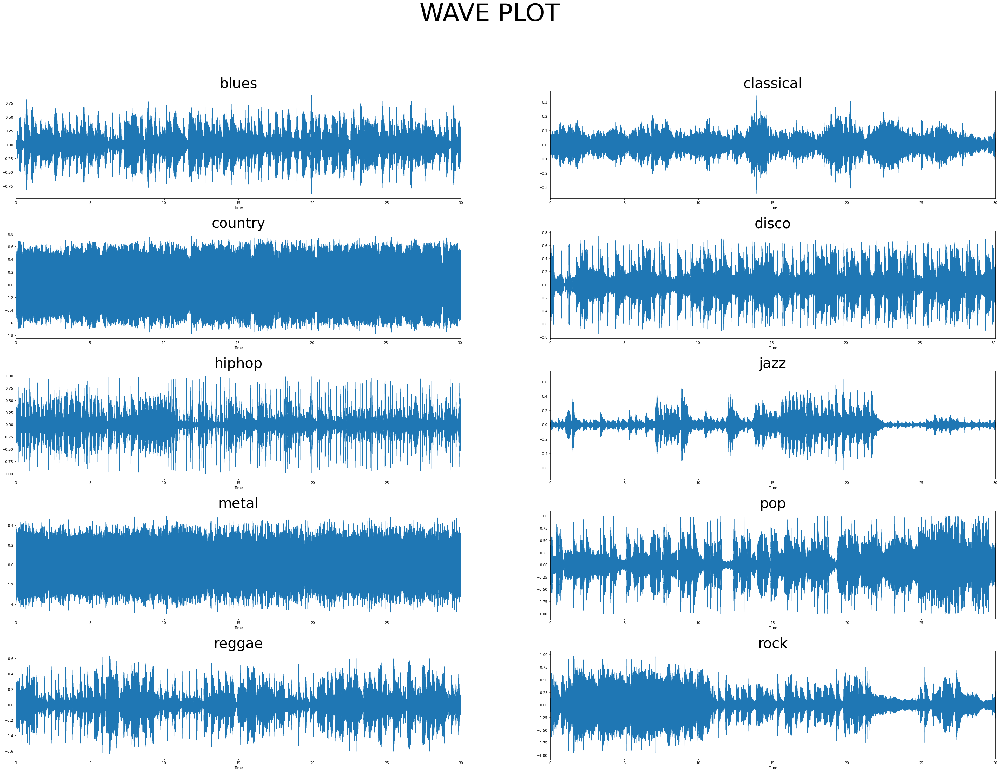

In [ ]:
plt.figure(figsize=(50, 35))
for i in range(len(genres)):
    path = f'./genres/{genres[i]}/{genres[i]}.00000.wav'
    x, sr = librosa.load(path)
    plt.subplot(5,2,1+i)
    plt.subplots_adjust(hspace=0.3)
    plt.title(genres[i],size=40)
    librosa.display.waveplot(x, sr=sr)    
plt.suptitle("WAVE PLOT",size=70)

#### Plotting Spectogram
A spectrogram is a visual representation of the spectrum of frequencies of a signal as it varies with time. When applied to an audio signal, spectrograms are sometimes called sonographs, voiceprints, or voicegrams.<br>
A sound spectrum is a representation of a sound – usually a short sample of a sound – in terms of the amount of vibration at each individual frequency. It is usually presented as a graph of either power or pressure as a function of frequency.

Text(0.5, 0.98, 'SPECTOGRAM')

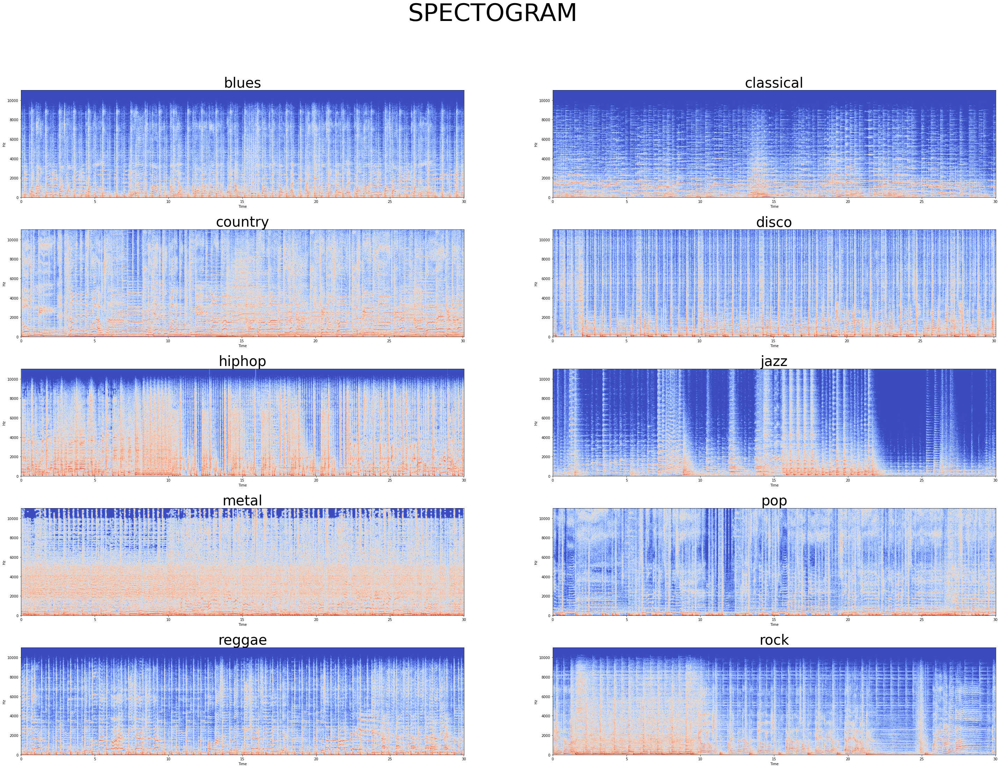

In [ ]:
plt.figure(figsize=(50, 35))
for i in range(len(genres)):
    path = f'./genres/{genres[i]}/{genres[i]}.00000.wav'
    x, sr = librosa.load(path)
    plt.subplot(5,2,1+i)
    plt.subplots_adjust(hspace=0.3)
    plt.title(genres[i],size=40)
    s = librosa.stft(x)
    Xdb = librosa.amplitude_to_db(abs(s))
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')    
plt.suptitle("SPECTOGRAM",size=70)

# Data Preprocessing 

For machine learning modeling, feature is extracted from the audio clips and stored in ztzan.csv file.

In [ ]:
data = pd.read_csv('gtzan.csv')

In [ ]:
data.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661500,0.349943,0.088760,0.130225,0.002829,1784.420446,129789.689238,2002.650192,85897.037189,...,52.459194,-1.691938,36.550671,-0.409953,41.642780,-2.300209,55.095062,1.219929,46.971306,blues
1,blues.00001.wav,661500,0.340983,0.094981,0.095918,0.002373,1529.835316,375984.023922,2038.617579,213794.462833,...,55.364937,-0.716537,60.107063,0.293876,48.157219,-0.287431,51.128483,0.531573,45.825054,blues
2,blues.00002.wav,661500,0.363603,0.085287,0.175573,0.002748,1552.481958,156526.317715,1747.165985,76046.707240,...,40.611088,-7.726901,47.675522,-1.815723,52.425110,-3.433434,46.624176,-2.226821,30.576178,blues
3,blues.00003.wav,661500,0.404779,0.094009,0.141191,0.006339,1070.119953,184498.418348,1596.333948,166561.564811,...,44.460136,-3.316932,50.234367,0.637982,37.344990,-0.619690,37.298714,-3.408233,31.976847,blues
4,blues.00004.wav,661500,0.308590,0.087850,0.091563,0.002304,1835.494603,343350.842007,1748.362448,88466.013315,...,86.031464,-5.453538,75.327103,-0.924161,53.583614,-4.409333,62.930351,-11.703781,55.235798,blues


##### Audio features descriptions: -
1. Chromagram: chromagram closely relates to
the twelve different pitch classes.
2. Zero-crossing rate: It is the rate of sign-changes along a signal, i.e., the rate at which the signal changes from positive    to zero to negative or from negative to zero to positive. 
3. MFCC: Mel Frequency Cepstral Coefficient
(MFCC), used for for identifying the linguistic
content and discarding all the other stuff which
carries information like background noise, emotion etc. Usually this related to the musical
instrument.
4. Harmonic: When a musical instrument is playing a note, what we are actually hearing is the fundamental pitch, which is the pitch being played by the instrument, accompanied by a series of frequencies that are usually heard as a single composite tone. Those frequencies that are integer multiples of the fundamental pitch's frequency are called harmonics.
5. Perceptual: Music involves the manipulation of sound. Our perception of music is thus influenced by how the auditory system encodes and retains acoustic information. 
6. Tempo (Beats per minute): It indicates the number of beats in one minute. For instance, a tempo notated as 60 BPM would mean that a beat sounds exactly once per second. 

In [ ]:
data['label'].value_counts()

country      100
jazz         100
hiphop       100
metal        100
blues        100
pop          100
rock         100
reggae       100
disco        100
classical    100
Name: label, dtype: int64

Text(0.5, 1.0, 'Correlation Heatmap')

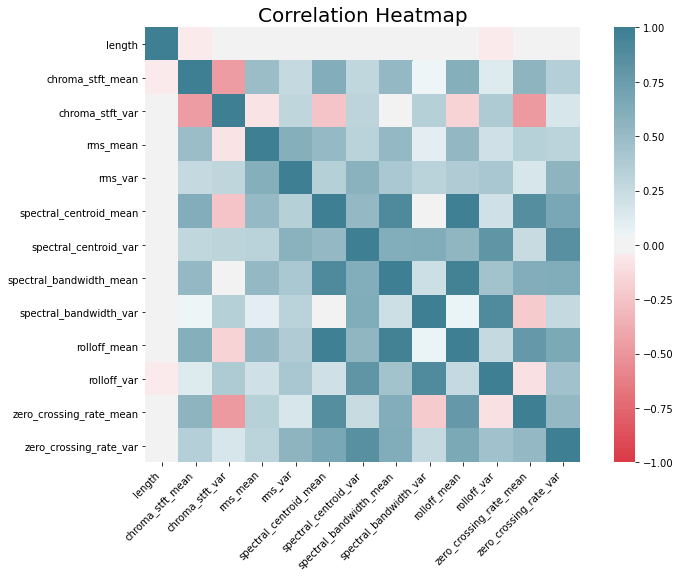

In [ ]:
plt.figure(figsize=(12, 8))
corr = data.iloc[:,1:14].corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(10, 220, n=200),
    square=True
    )
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);
plt.title('Correlation Heatmap', fontsize = 20)

#### Seperate feature vector and target

In [ ]:
# Seperate X and y
X = data.iloc[:, :-1]
y = data.iloc[:, -1]

In [ ]:
print("Shape of X: ", X.shape)
print("Shape of y: ", y.shape)

Shape of X:  (1000, 54)
Shape of y:  (1000,)


In [ ]:
X = X.drop(['filename'],axis=1)
X.head()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
0,661500,0.349943,0.088760,0.130225,0.002829,1784.420446,129789.689238,2002.650192,85897.037189,3806.485316,...,0.750948,52.459194,-1.691938,36.550671,-0.409953,41.642780,-2.300209,55.095062,1.219929,46.971306
1,661500,0.340983,0.094981,0.095918,0.002373,1529.835316,375984.023922,2038.617579,213794.462833,3548.820207,...,0.936109,55.364937,-0.716537,60.107063,0.293876,48.157219,-0.287431,51.128483,0.531573,45.825054
2,661500,0.363603,0.085287,0.175573,0.002748,1552.481958,156526.317715,1747.165985,76046.707240,3040.514948,...,2.455806,40.611088,-7.726901,47.675522,-1.815723,52.425110,-3.433434,46.624176,-2.226821,30.576178
3,661500,0.404779,0.094009,0.141191,0.006339,1070.119953,184498.418348,1596.333948,166561.564811,2185.028454,...,0.780977,44.460136,-3.316932,50.234367,0.637982,37.344990,-0.619690,37.298714,-3.408233,31.976847
4,661500,0.308590,0.087850,0.091563,0.002304,1835.494603,343350.842007,1748.362448,88466.013315,3580.945013,...,-4.512165,86.031464,-5.453538,75.327103,-0.924161,53.583614,-4.409333,62.930351,-11.703781,55.235798


#### Feature Scaling

In [ ]:
from sklearn.preprocessing import LabelEncoder, StandardScaler

In [ ]:
scaler = StandardScaler()
X = scaler.fit_transform(np.array(X, dtype = float))

In [ ]:
encoder = LabelEncoder()
y = encoder.fit_transform(y)

In [ ]:
print("X Shape: ", X.shape)
print("y shape: ", y.shape)
print("X dtype: ", type(X))
print("y dtype: ", type(y))

X Shape:  (1000, 53)
y shape:  (1000,)
X dtype:  <class 'numpy.ndarray'>
y dtype:  <class 'numpy.ndarray'>


In [ ]:
y.shape[0]

1000

In [ ]:
print("Class Encodings")
for i in range(len(encoder.classes_)):
    print(i," ---> ", encoder.classes_[i])

Class Encodings
0  --->  blues
1  --->  classical
2  --->  country
3  --->  disco
4  --->  hiphop
5  --->  jazz
6  --->  metal
7  --->  pop
8  --->  reggae
9  --->  rock


#### Splitting the dataset into test and train set

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1)

In [ ]:
print("X_train shape: ", X_train.shape)
print("y_train shape: ", y_train.shape)
print("X_test shape: ", X_test.shape)
print("y_test shape: ", y_test.shape)

X_train shape:  (900, 53)
y_train shape:  (900,)
X_test shape:  (100, 53)
y_test shape:  (100,)


# Model creation

In [ ]:
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
import catboost as cb
from xgboost import XGBClassifier, XGBRFClassifier

In [ ]:
def model_eval(model, title = "Default"):
    model.fit(X_train, y_train)
    pred = model.predict(X_test)
    print('Accuracy', title, ':', round(accuracy_score(y_test, pred), 5), '\n')

In [ ]:
# Logistic Regression
lg = LogisticRegression(random_state=0, multi_class='multinomial')
model_eval(lg, "Logistic Regression")

# Stochastic Gradient Descent
sgd = SGDClassifier(max_iter=5000, random_state=0)
model_eval(sgd, "Stochastic Gradient Descent")

# KNN
knn = KNeighborsClassifier(n_neighbors=19)
model_eval(knn, "KNN")

# Naive Bayes
nb = GaussianNB()
model_eval(nb, "Naive Bayes")

# Support Vector Machine
svm = SVC(kernel = 'rbf', random_state = 0)
model_eval(svm, "Support Vector Machine")

# Decission trees
tree = DecisionTreeClassifier()
model_eval(tree, "Decission trees")

# Random Forest
rforest = RandomForestClassifier(n_estimators=1000, max_depth=10, random_state=0)
model_eval(rforest, "Random Forest")

# Neural Nets
nn = MLPClassifier(solver='lbfgs', alpha=1e-5, hidden_layer_sizes=(5000, 10), random_state=1)
model_eval(nn, "Neural Nets")

# catboost
cbc = cb.CatBoostClassifier(verbose=0, eval_metric='Accuracy', loss_function='MultiClass')
model_eval(cbc,"Cat Boost Classifier")

# Cross Gradient Booster
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05)
model_eval(xgb, "Cross Gradient Booster")

# Cross Gradient Booster (Random Forest)
xgbrf = XGBRFClassifier(objective= 'multi:softmax')
model_eval(xgbrf, "Cross Gradient Booster (Random Forest)")

Accuracy Logistic Regression : 0.69 

Accuracy Stochastic Gradient Descent : 0.75 

Accuracy KNN : 0.67 

Accuracy Naive Bayes : 0.57 

Accuracy Support Vector Machine : 0.77 

Accuracy Decission trees : 0.62 

Accuracy Random Forest : 0.73 

Accuracy Neural Nets : 0.66 

Accuracy Cat Boost Classifier : 0.77 

[19:25:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy Cross Gradient Booster : 0.73 

[19:26:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy Cross Gradient B

Higesht accuracy is given by cat boost Model.

In [ ]:
# Final model
cbc = cb.CatBoostClassifier(verbose=0, eval_metric='Accuracy', loss_function='MultiClass')
cbc.fit(X_train, y_train)
pred = cbc.predict(X_test)
print('Accuracy Cat Boost:', round(accuracy_score(y_test, pred)*100, 5), '\n')

Accuracy Cat Boost: 77.0 



# Prediction

In [ ]:
def audio_feature(path):
    #feature=[]
    y, sr = librosa.load(path, mono=True, duration=30)
    length = y.shape[0]
    chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)        
    rmse = librosa.feature.rms(y=y)
    spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)
    spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)
    rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y)
    mfcc = librosa.feature.mfcc(y=y, sr=sr)
    to_append = f'{length} {np.mean(chroma_stft)} {np.var(chroma_stft)} {np.mean(rmse)} {np.var(rmse)} {np.mean(spec_cent)} {np.var(spec_cent)} {np.mean(spec_bw)} {np.var(spec_bw)} {np.mean(rolloff)} {np.var(rolloff)} {np.mean(zcr)} {np.var(zcr)}'    
    for e in mfcc:
        to_append += f' {np.mean(e)} {np.var(e)}'
    feature = scaler.transform(np.array(to_append.split()).reshape(1,-1))
    return feature

In [ ]:
def predict_music_genre(path):
    ftr = audio_feature(path)
    gen = encoder.classes_[cbc.predict(ftr)[0][0]]
    return gen

In [ ]:
paths = ['./genres/blues/blues.00031.wav', './genres/classical/classical.00042.wav', 
         './genres/country/country.00060.wav', './genres/disco/disco.00092.wav', 
         './genres/hiphop/hiphop.00018.wav', './genres/jazz/jazz.00059.wav', 
         './genres/metal/metal.00075.wav', './genres/pop/pop.00084.wav',
         './genres/reggae/reggae.00096.wav', './genres/rock/rock.00066.wav']

In [ ]:
for path in paths:
    IPython.display.display(IPython.display.Markdown("### Playing audio from "+ path))
    IPython.display.display(IPython.display.Audio(path))
    IPython.display.display(IPython.display.Markdown("#### Predicted Genre: "+ predict_music_genre(path)))

### Playing audio from ./genres/blues/blues.00031.wav

#### Predicted Genre: blues

### Playing audio from ./genres/classical/classical.00042.wav

#### Predicted Genre: classical

### Playing audio from ./genres/country/country.00060.wav

#### Predicted Genre: country

### Playing audio from ./genres/disco/disco.00092.wav

#### Predicted Genre: disco

### Playing audio from ./genres/hiphop/hiphop.00018.wav

#### Predicted Genre: hiphop

### Playing audio from ./genres/jazz/jazz.00059.wav

#### Predicted Genre: jazz

### Playing audio from ./genres/metal/metal.00075.wav

#### Predicted Genre: metal

### Playing audio from ./genres/pop/pop.00084.wav

#### Predicted Genre: pop

### Playing audio from ./genres/reggae/reggae.00096.wav

#### Predicted Genre: reggae

### Playing audio from ./genres/rock/rock.00066.wav

#### Predicted Genre: rock